## Halbach optimization

Sweep Halbach function

In [1]:
import numpy as np
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import halbach_cylinder
import magpylib as magpy
from magpylib.magnet import Cylinder,CylinderSegment

def sweep_halbach(s_dict):
    """
    conf_dict:
        center_D: central big diameter to scan around
        dD: step size to scan big radius
        center_c_d: center cylinder diameter to scan around
        dcd: step size to scan cylinder diameter
        center_c_h: center cylinder height to scan around
        dch: step size to scan big height
        n_steps: number of steps
        min_N: min number of cylinders
        max_N: maximum number of cylinders
        alternate: flags whether or not to use on-axis or off-axis halbach
        scan_depth: number of times to repeat scan (optional)
        shrink_factor: factor to shrink step size on each repetition (optional)
        Br: absolute remanence value
        min_Bcenter: minimum center B field in Gauss
        max_av_nonuniformity: maximum average nonuniformity
        x_bounds: grid bounds
        y_bounds: grid bounds
    """
    sweep = s_dict.copy()
    Br = sweep["Br"]
    grid = make_grid(sweep["x_bounds"], sweep["y_bounds"], sweep["grid_res"])
    if(("scan_depth" not in s_dict) or ("shrink_factor" not in s_dict)):
        sweep["shrink_factor"] = 1
        sweep["scan_depth"] = 1
    
    possible_confs = []
    for depth_i in range(sweep["scan_depth"]):
        D_sweep = centered_sweep_range(sweep["center_D"], sweep["D_steps"], sweep["dD"])
        c_d_sweep = centered_sweep_range(sweep["center_c_d"], sweep["c_d_steps"], sweep["dcd"])
        c_h_sweep = centered_sweep_range(sweep["center_c_h"], sweep["c_h_steps"], sweep["dch"])
        N_sweep = np.arange(sweep["min_N"], 1+sweep["max_N"])
#         startD = sweep["center_D"] + int(sweep["n_steps"] / 2) * sweep["dD"]
#         stopD = sweep["center_D"] - int(sweep["n_steps"] / 2) * sweep["dD"]
#         D_sweep = np.linspace(start=startD, stop=stopD, num=(sweep["n_steps"] + 1 if (sweep["n_steps"] % 2 == 0) else sweep["n_steps"]))
        for D in D_sweep:
            for c_d in c_d_sweep:
                for c_h in c_h_sweep:
                    for N in N_sweep:
                        magnets = halbach_cylinder(Br, c_d, c_h, D, int(N), alternate=True)
#                         print(Br, c_d, c_h, D, int(N))
                        grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, sweep["grid_res"])
#                         print(max_nonuniformity)
                        if (center_field > sweep["min_Bcenter"] and
                            av_nonuniformity < sweep["max_av_nonuniformity"] and
                            max_nonuniformity < sweep["max_abs_nonuniformity"]):
                            possible_confs.append(
                                {"Br": Br,
                                 "c_d": c_d,
                                 "c_h": c_h,
                                 "D": D,
                                 "N": N,
                                 "av": av_nonuniformity,
                                 "max": max_nonuniformity,
                                 "Bcenter": center_field
                                }
                            )

        #
        possible_confs.sort(key=lambda item: item.get("av"))
        print(possible_confs[:5])
        return possible_confs

## Sweep 1
Define sweep configuration and run sweep #1

In [4]:
s_dict = {
    "center_D": 32,
    "dD": 3,
    "D_steps": 10,
    "center_c_d": 4,
    "c_d_steps": 1,
    "dcd": 1,
    "center_c_h": 210,
    "c_h_steps": 1,
    "dch": 5,
#     "n_steps": 3,
    "min_N": 5,
    "max_N": 10,
    "alternate": True,
    "Br": 1.09,
    "min_Bcenter": 0.2,
    "max_av_nonuniformity": 5e-6,
    "max_abs_nonuniformity": 5e-6,
    "x_bounds": [-6, 6],
    "y_bounds": [-5, 5],
    "grid_res": 101
#     scan_depth: number of times to repeat scan (optional)
#     shrink_factor: factor to shrink step size on each repetition (optional)
}

# 1.09 5.0 210.0 17.0 3
confs = sweep_halbach(s_dict)

[{'Br': 1.09, 'c_d': 4.0, 'c_h': 210.0, 'D': 29.0, 'N': 9, 'av': 9.033597962105656e-07, 'max': 4.233544492713532e-06, 'Bcenter': 0.9330515808601105}, {'Br': 1.09, 'c_d': 4.0, 'c_h': 210.0, 'D': 32.0, 'N': 9, 'av': 1.2271951718377751e-06, 'max': 4.255804726572137e-06, 'Bcenter': 0.7662572410157896}]


Best result from sweep

Maximum B-field along +z direction: 1.746 G
Central B-field along +z axis: 0.933 G
Maximum B-field along +x direction: 0.933 G
Central B-field along +x axis: 0.933 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:6.301532165420885e-07
Min axial nonuniformity: 0.0
Max axial nonuniformity:0.0006879014487423702


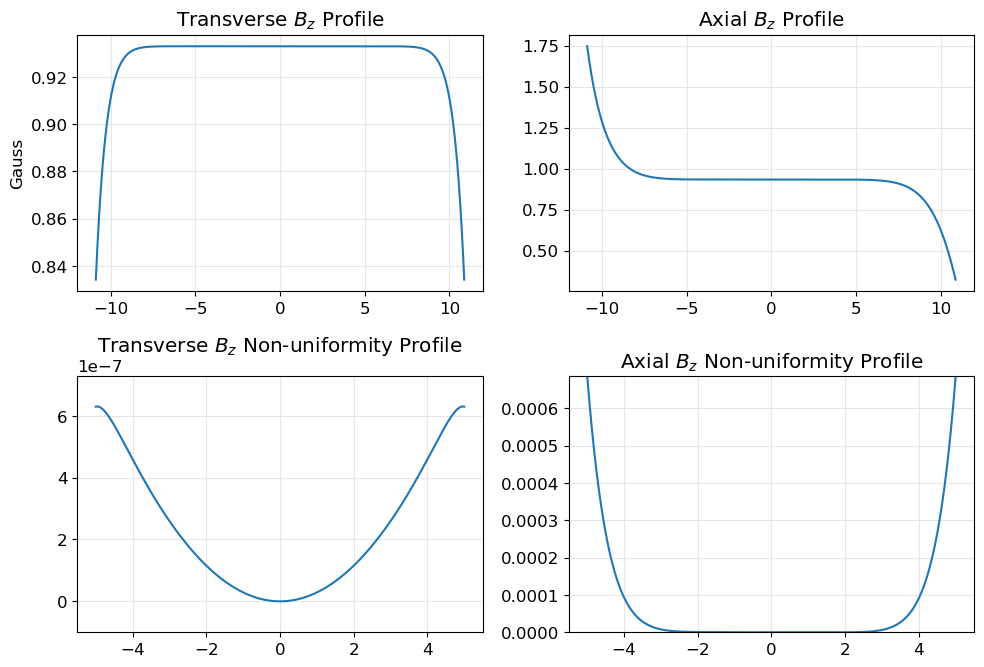

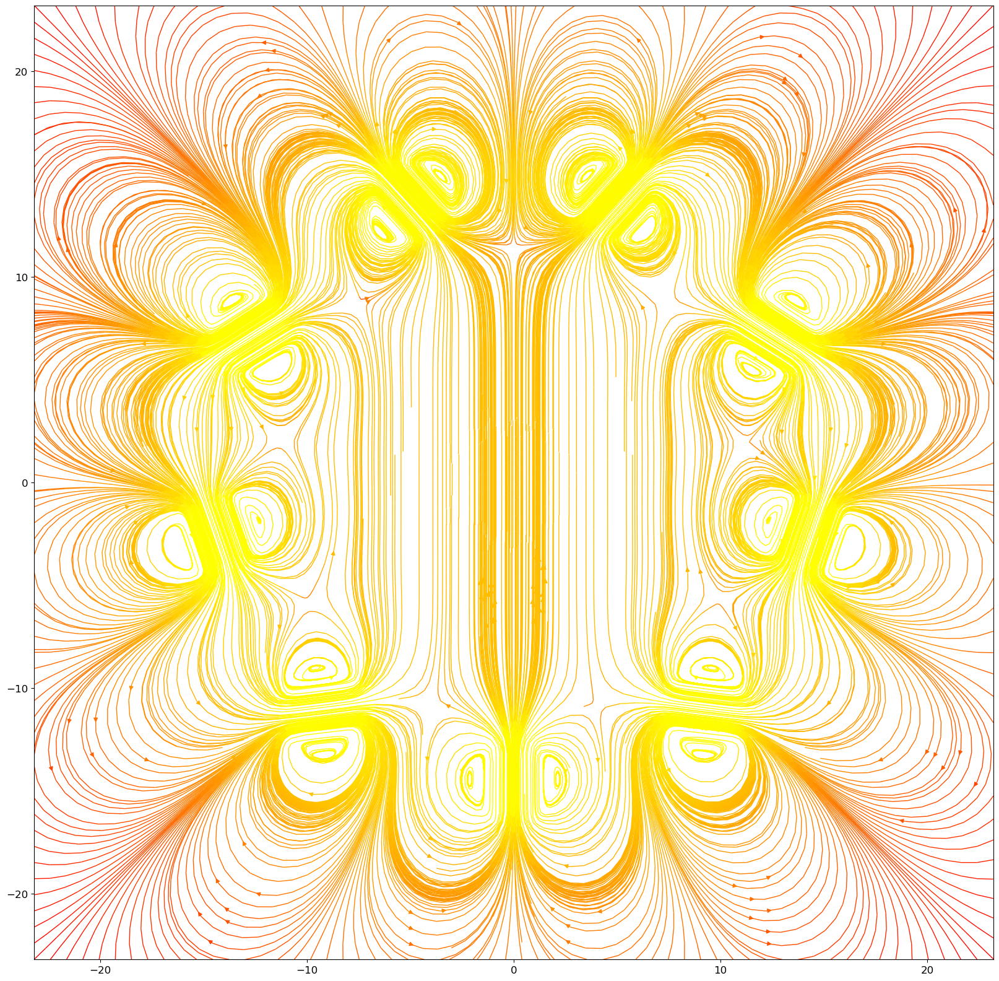

In [30]:
best_conf = confs[0]
magnets = halbach_cylinder(best_conf["Br"],
                           best_conf["c_d"],
                           best_conf["c_h"],
                           best_conf["D"],
                           best_conf["N"],
                           True)
x_len = 5
D = best_conf["D"]
get_field_on_axes(magnets, D*0.75, D*0.75, [-x_len,x_len], [-x_len,x_len])

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

## Halnach Nelder-Mead Optimization experiment #1
Optimizing for average nonuniformity over 4cm^2 area

In [6]:
from scipy.optimize import minimize, Bounds

Br = 1.09
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)

def nonuniformity(x):
    D, c_d, c_h, N = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

bounds = Bounds([10, 2, 160, 4], [40, 6, 210, 20])
# D, c_d, c_h, N
x0 = [32, 4, 180, 11]

# fatol is the absolute error between iterations that is acceptable for convergence
res = minimize(nonuniformity, x0, method="Nelder-Mead", options={'disp':True, 'fatol': 1e-8}, bounds=bounds)

print(res)

Optimization terminated successfully.
         Current function value: 0.000010
         Iterations: 182
         Function evaluations: 324
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 9.881454783619801e-06
             x: [ 3.704e+01  6.000e+00  2.100e+02  1.060e+01]
           nit: 182
          nfev: 324
 final_simplex: (array([[ 3.704e+01,  6.000e+00,  2.100e+02,  1.060e+01],
                       [ 3.704e+01,  6.000e+00,  2.100e+02,  1.060e+01],
                       ...,
                       [ 3.704e+01,  6.000e+00,  2.100e+02,  1.060e+01],
                       [ 3.704e+01,  6.000e+00,  2.100e+02,  1.060e+01]]), array([ 9.881e-06,  9.881e-06,  9.881e-06,  9.881e-06,
                        9.881e-06]))


Maximum B-field along +z direction: 2.439 G
Central B-field along +z axis: 1.573 G
Maximum B-field along +x direction: 1.573 G
Central B-field along +x axis: 1.573 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:1.1746557369050914e-06
Min axial nonuniformity: 0.0
Max axial nonuniformity:4.088581236208934e-06


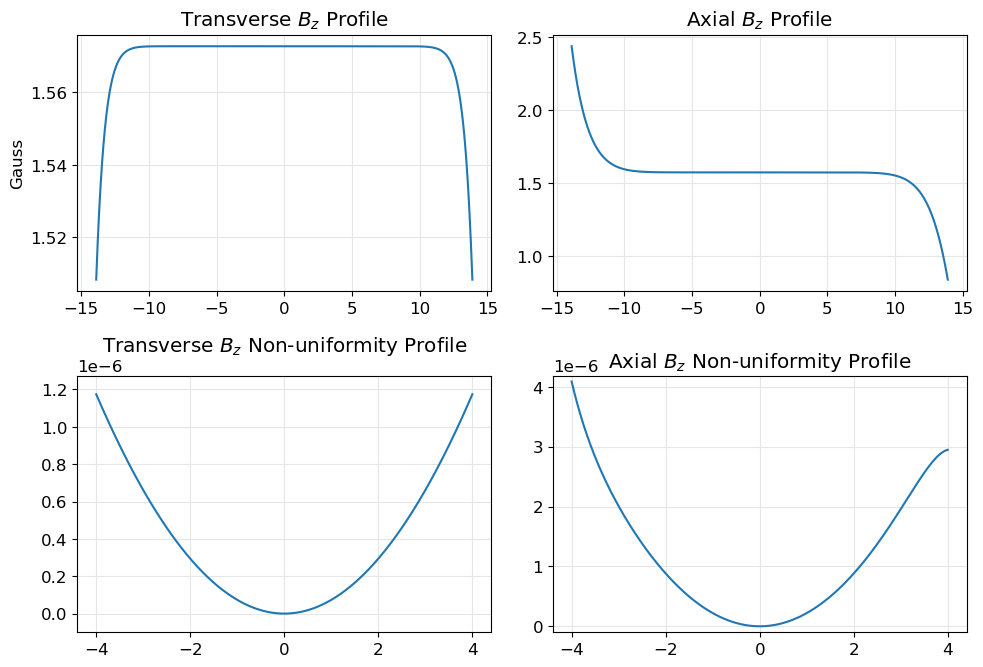

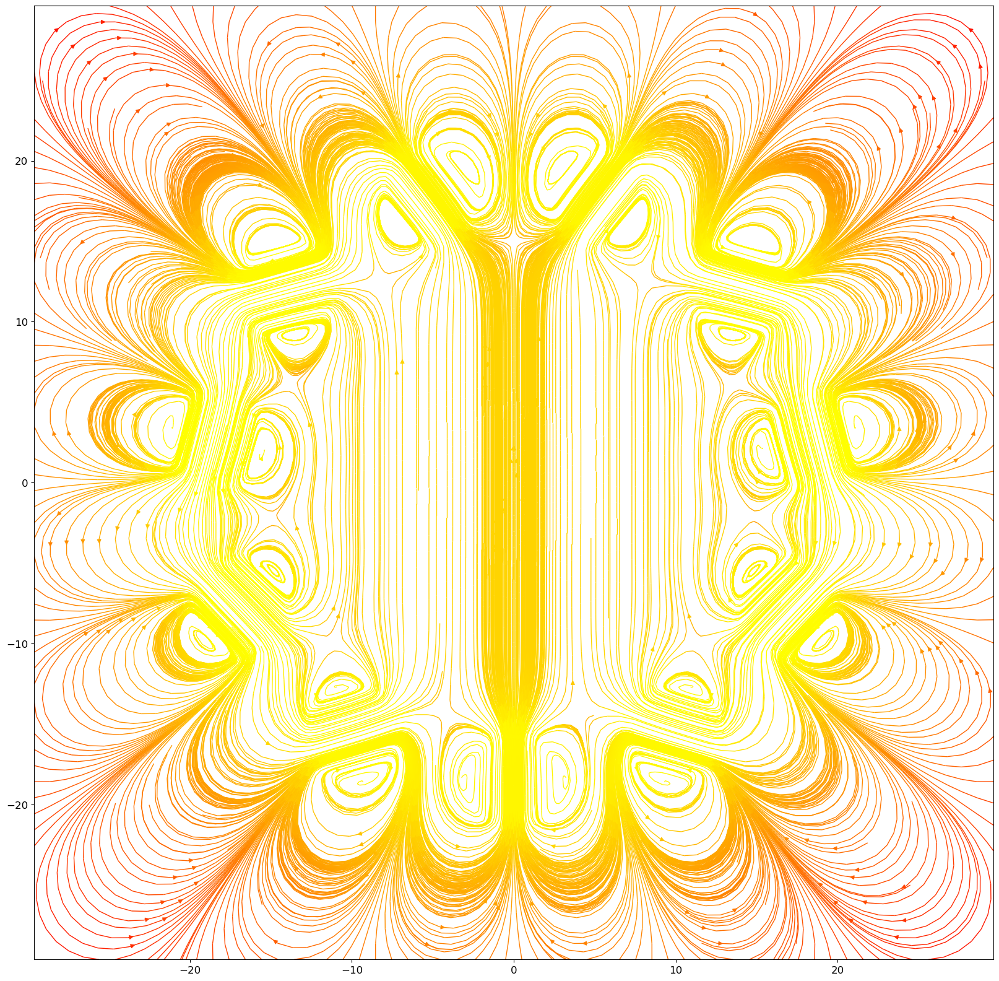

In [7]:
D, c_d, c_h, N = res.x
magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
x_len = 4
get_field_on_axes(magnets, D*0.75, D*0.75, [-x_len,x_len], [-x_len,x_len])

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [8]:
bounds = Bounds([10, 2, 160, 4], [40, 6, 210, 12])
# D, c_d, c_h, N
x0 = [32, 4, 160, 9]

# fatol is the absolute error between iterations that is acceptable for convergence
res = minimize(nonuniformity, x0, method="Nelder-Mead", options={'disp':True, 'fatol': 1e-15}, bounds=bounds)

print(res)

Optimization terminated successfully.
         Current function value: 0.000015
         Iterations: 57
         Function evaluations: 143
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 1.538089404756512e-05
             x: [ 4.000e+01  6.000e+00  2.100e+02  9.338e+00]
           nit: 57
          nfev: 143
 final_simplex: (array([[ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       ...,
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00]]), array([ 1.538e-05,  1.538e-05,  1.538e-05,  1.538e-05,
                        1.538e-05]))


Maximum B-field along +z direction: 2.065 G
Central B-field along +z axis: 1.103 G
Maximum B-field along +x direction: 1.103 G
Central B-field along +x axis: 1.103 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:2.4485735438436355e-06
Min axial nonuniformity: 0.0
Max axial nonuniformity:4.521988678988323e-05


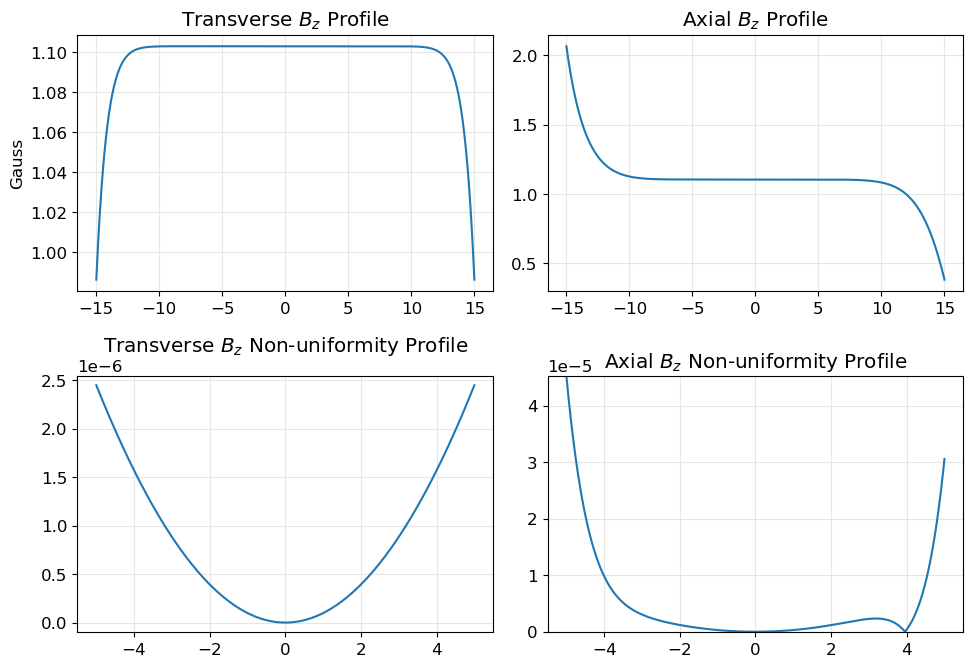

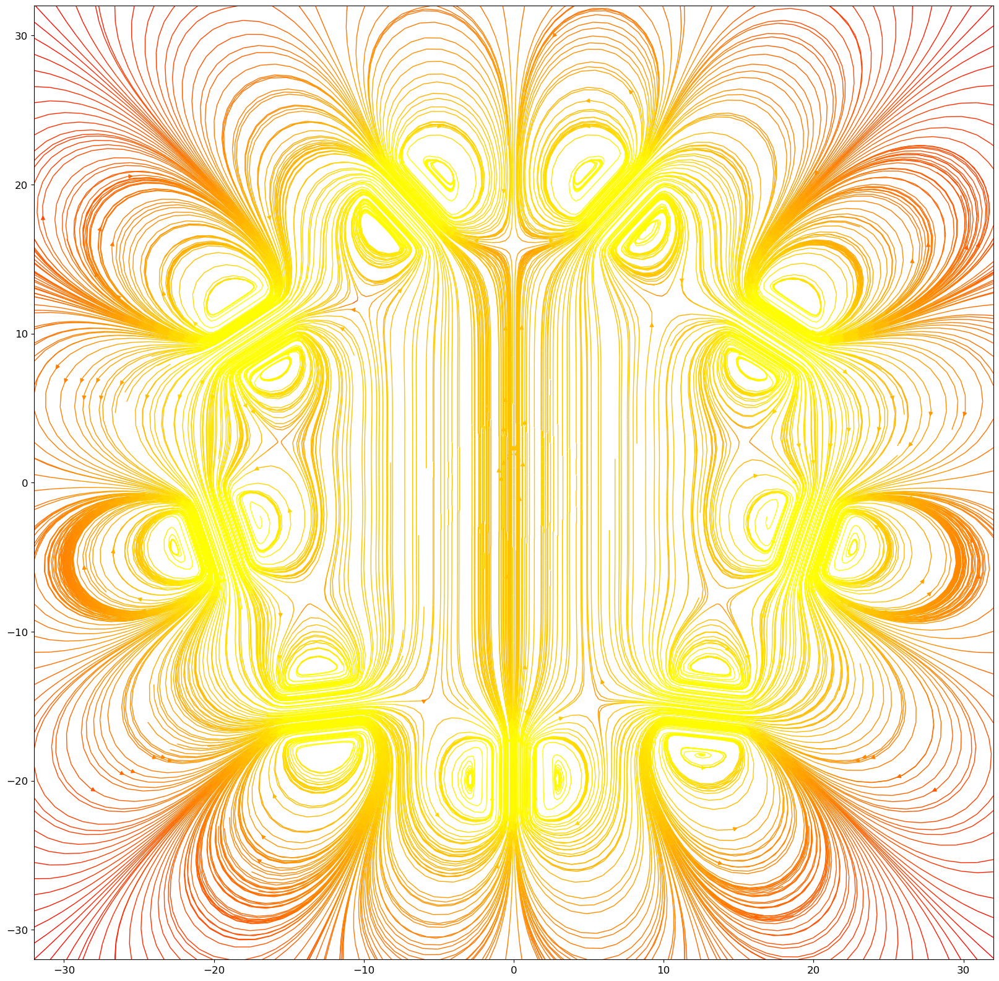

In [9]:
D, c_d, c_h, N = res.x
magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
x_len = 5
get_field_on_axes(magnets, D*0.75, D*0.75, [-x_len,x_len], [-x_len,x_len])

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [75]:
bounds = Bounds([10, 2, 160, 4], [40, 6, 210, 12])
# D, c_d, c_h, N
x0 = [32, 4, 160, 6]

# fatol is the absolute error between iterations that is acceptable for convergence
# res = minimize(nonuniformity, x0, method="trust-constr", options={'disp':True}, bounds=bounds)
# res = minimize(nonuniformity, x0, method="powell", options={'disp':True}, bounds=bounds)
# res = minimize(nonuniformity, x0, method="l-bfgs-b", options={'disp':True, 'ftol':1e-10, 'gtol':1e-10}, bounds=bounds)


       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 1.538089404756512e-05
             x: [ 4.000e+01  6.000e+00  2.100e+02  9.338e+00]
           nit: 57
          nfev: 143
 final_simplex: (array([[ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       ...,
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00]]), array([ 1.538e-05,  1.538e-05,  1.538e-05,  1.538e-05,
                        1.538e-05]))


## Halnach Nelder-Mead Optimization experiment #2
Run from N = 1..12 and optimize each then plot results

In [31]:
from scipy.optimize import minimize, Bounds

def run_optimizer(min_N, max_N, x0, bounds, method, options):
    Br = 1.09
    grid_res = 101
    grid = make_grid([-7, 7], [-7, 7], grid_res)
    results = {}
    for i in range(min_N, 1+max_N):
        def max_nonuniformity(x):
            c_d, c_h, D = x
            magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(i)), alternate=True)
            grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
            return max_abs_nonuniformity
        res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
#         print(str(i), res)
        results[str(i)] = {"val": res.fun, "x": res.x}
    return results


In [34]:
bounds = Bounds([2, 160, 10], [6, 210, 40])
# c_d, c_h, D
x0 = [2, 160, 32]
options = {'disp':False, 'fatol': 1e-14}
method = "Nelder-mead"
min_N = 5
max_N = 21
results = run_optimizer(min_N, max_N, x0, bounds, method, options)
print(results)

{'5': {'val': 0.0003179344650644385, 'x': array([  6., 210.,  40.])}, '6': {'val': 0.012922694512216493, 'x': array([  6., 210.,  40.])}, '7': {'val': 2.0581503275193145e-05, 'x': array([  6., 210.,  40.])}, '8': {'val': 0.002041136302796214, 'x': array([  6., 210.,  40.])}, '9': {'val': 1.0156530255842899e-05, 'x': array([  2.02566088, 210.        ,  33.61177818])}, '10': {'val': 0.0003083879242900762, 'x': array([  6., 210.,  40.])}, '11': {'val': 6.204501067425851e-06, 'x': array([  2.        , 210.        ,  29.56757282])}, '12': {'val': 5.8319291245063347e-05, 'x': array([  6., 210.,  40.])}, '13': {'val': 4.297828230560563e-06, 'x': array([  2.        , 210.        ,  26.89462105])}, '14': {'val': 1.9575617412896482e-05, 'x': array([  6., 210.,  40.])}, '15': {'val': 3.23461925569056e-06, 'x': array([  2.        , 209.99998266,  25.00167722])}, '16': {'val': 1.3924825525741532e-05, 'x': array([  2.16382164, 210.        ,  36.51522973])}, '17': {'val': 2.578795522921009e-06, 'x': 

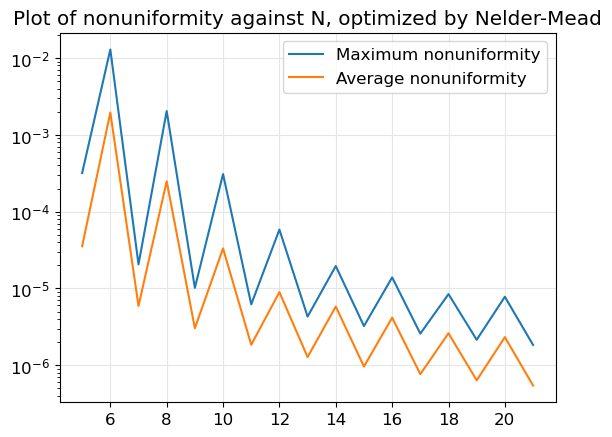

In [35]:
import matplotlib.pyplot as plt

n = np.arange(min_N,1+max_N)
max_non = []
av_non = []
Br = 1.09
grid_res = 101
grid = make_grid([-7, 7], [-7, 7], grid_res)
for i in range (min_N, 1+max_N):
    max_non.append(results[str(i)]["val"])
    c_d, c_h, D = results[str(i)]["x"]
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(i)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    av_non.append(av_nonuniformity)
#     max_non.append(max_abs_nonuniformity)

plt.plot(n, max_non, label="Maximum nonuniformity")
plt.plot(n, av_non, label="Average nonuniformity")
plt.grid(color='.9', which='major', axis='both', linestyle='-')
plt.yscale("log")
plt.title("Plot of nonuniformity against N, optimized by Nelder-Mead")
plt.legend()

In [3]:
import numpy as np
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import halbach_cylinder
import magpylib as magpy
from scipy.optimize import minimize, Bounds

Br = 1.09
grid_res = 101
grid = make_grid([-5, 5], [-5, 5], grid_res)
N_test = 9

def nonuniformity2(x):
    D, c_d, c_h = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N_test)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

def max_nonuniformity(x):
    D, c_d, c_h = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N_test)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_nonuniformity

bounds = Bounds([10, 2, 160], [40, 6, 210])
# D, c_d, c_h, N
x0 = [32, 2, 160]

# fatol is the absolute error between iterations that is acceptable for convergence
res = minimize(max_nonuniformity, x0, method="Nelder-Mead", options={'disp':True, 'fatol': 1e-12}, bounds=bounds)
print(res)


Optimization terminated successfully.
         Current function value: 0.000002
         Iterations: 114
         Function evaluations: 261
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 2.0011289739762793e-06
             x: [ 2.632e+01  2.000e+00  2.100e+02]
           nit: 114
          nfev: 261
 final_simplex: (array([[ 2.632e+01,  2.000e+00,  2.100e+02],
                       [ 2.632e+01,  2.000e+00,  2.100e+02],
                       [ 2.632e+01,  2.000e+00,  2.100e+02],
                       [ 2.632e+01,  2.000e+00,  2.100e+02]]), array([ 2.001e-06,  2.001e-06,  2.001e-06,  2.001e-06]))


## Powell optimization

In [42]:
res = minimize(max_nonuniformity, x0, method="powell", options={'disp':True}, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000002
         Iterations: 4
         Function evaluations: 342
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 2.0708743094124697e-06
       x: [ 2.593e+01  6.000e+00  2.100e+02]
     nit: 4
   direc: [[ 1.209e+00 -6.393e-01 -7.991e+00]
           [ 0.000e+00  1.000e+00  0.000e+00]
           [ 1.015e-02  2.315e-02  2.898e-01]]
    nfev: 342
